## Set-up environment

Let's start by installing 🤗 Transformers and [EasyOCR](https://github.com/JaidedAI/EasyOCR) (an open-source OCR engine). Google Colab already comes with Transformers pre-installed.

In [6]:
!pip install -q transformers
!pip install -q easyocr

In [11]:
import fitz  # PyMuPDF
from PIL import Image
from torchvision import transforms

## Prepare image for the model

Preparing the image for the model can be done as follows:

In [17]:
from torchvision import transforms

class MaxResize(object):
    def __init__(self, max_size=800):
        self.max_size = max_size

    def __call__(self, image):
        width, height = image.size
        current_max_size = max(width, height)
        scale = self.max_size / current_max_size
        resized_image = image.resize((int(round(scale*width)), int(round(scale*height))))

        return resized_image

detection_transform = transforms.Compose([
    MaxResize(800),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

## Forward pass

Next, we forward the pixel values through the model. The model outputs logits of shape (batch_size, num_queries, num_labels + 1). The +1 is for the "no object" class.

In [23]:
import torch

with torch.no_grad():
  outputs = model(pixel_values)

In [24]:
outputs.logits.shape

torch.Size([1, 15, 3])

## Postprocessing

Next, we take the prediction that has an actual class (i.e. not "no object").

In [25]:
# for output bounding box post-processing
def box_cxcywh_to_xyxy(x):
    x_c, y_c, w, h = x.unbind(-1)
    b = [(x_c - 0.5 * w), (y_c - 0.5 * h), (x_c + 0.5 * w), (y_c + 0.5 * h)]
    return torch.stack(b, dim=1)


def rescale_bboxes(out_bbox, size):
    img_w, img_h = size
    b = box_cxcywh_to_xyxy(out_bbox)
    b = b * torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32)
    return b


# update id2label to include "no object"
id2label = model.config.id2label
id2label[len(model.config.id2label)] = "no object"


def outputs_to_objects(outputs, img_size, id2label):
    m = outputs.logits.softmax(-1).max(-1)
    pred_labels = list(m.indices.detach().cpu().numpy())[0]
    pred_scores = list(m.values.detach().cpu().numpy())[0]
    pred_bboxes = outputs['pred_boxes'].detach().cpu()[0]
    pred_bboxes = [elem.tolist() for elem in rescale_bboxes(pred_bboxes, img_size)]

    objects = []
    for label, score, bbox in zip(pred_labels, pred_scores, pred_bboxes):
        class_label = id2label[int(label)]
        if not class_label == 'no object':
            objects.append({'label': class_label, 'score': float(score),
                            'bbox': [float(elem) for elem in bbox]})

    return objects

In [26]:
objects = outputs_to_objects(outputs, image.size, id2label)

NameError: name 'image' is not defined

## Load model

Next, we load a Table Transformer pre-trained for table detection. We use the "no_timm" version here to load the checkpoint with a Transformers-native backbone.

In [12]:
from transformers import AutoModelForObjectDetection

model = AutoModelForObjectDetection.from_pretrained("microsoft/table-transformer-detection", revision="no_timm")

In [13]:
model.config.id2label

{0: 'table', 1: 'table rotated'}

We move the model to a GPU if it's available (predictions will be faster).

In [14]:
import torch

device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)
print("")

## Load image

Next, we can load a PDF image.

## Crop table

Next, we crop the table out of the image. For that, the TATR authors employ some padding to make sure the borders of the table are included.

## Load structure recognition model

Next, we load a Table Transformer pre-trained for table structure recognition.

In [84]:
#cropped_table = tables_crops[0]['image'].convert("RGB")
#cropped_table
file_path = "page_1_1002.png"
cropped_table = Image.open(file_path).convert("RGB")
type(cropped_table)

PIL.Image.Image

In [85]:
from transformers import TableTransformerForObjectDetection

# new v1.1 checkpoints require no timm anymore
structure_model = TableTransformerForObjectDetection.from_pretrained("microsoft/table-structure-recognition-v1.1-all")
structure_model.to(device)
print("")

We prepare the cropped table image for the model, and perform a forward pass.

In [86]:
structure_transform = transforms.Compose([
    MaxResize(1000),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

In [87]:
pixel_values = structure_transform(cropped_table).unsqueeze(0)
pixel_values = pixel_values.to(device)
print(pixel_values.shape)

torch.Size([1, 3, 1000, 819])


In [88]:
# forward pass
with torch.no_grad():
  outputs = structure_model(pixel_values)

Next, we get the predicted detections.

In [89]:
# update id2label to include "no object"
structure_id2label = structure_model.config.id2label
structure_id2label[len(structure_id2label)] = "no object"

cells = outputs_to_objects(outputs, cropped_table.size, structure_id2label)
print(cells)

[{'label': 'table row', 'score': 0.9817537665367126, 'bbox': [144.88963317871094, 2956.58203125, 6974.63330078125, 3202.082763671875]}, {'label': 'table row', 'score': 0.9245811104774475, 'bbox': [142.28671264648438, 5675.70458984375, 6973.8759765625, 5984.029296875]}, {'label': 'table projected row header', 'score': 0.8527759909629822, 'bbox': [144.50198364257812, 3909.70458984375, 6976.69140625, 4154.9609375]}, {'label': 'table row', 'score': 0.988865315914154, 'bbox': [145.17881774902344, 1362.491455078125, 6972.57421875, 1593.098388671875]}, {'label': 'table row', 'score': 0.9847891330718994, 'bbox': [142.4400177001953, 3431.822998046875, 6972.8017578125, 3661.429931640625]}, {'label': 'table row', 'score': 0.9426705837249756, 'bbox': [140.1452178955078, 4806.63720703125, 6975.71923828125, 5066.6552734375]}, {'label': 'table row', 'score': 0.6942523121833801, 'bbox': [140.36146545410156, 4657.28076171875, 6973.55810546875, 4887.98779296875]}, {'label': 'table column', 'score': 0.99

## Visualize cells

We can visualize all recognized cells using PIL's ImageDraw module.

In [90]:
from PIL import ImageDraw

cropped_table_visualized = cropped_table.copy()
draw = ImageDraw.Draw(cropped_table_visualized)

for cell in cells:
    draw.rectangle(cell["bbox"], outline="red")

cropped_table_visualized

An alternative way of plotting is to select one class to visualize, like "table row":

In [91]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.patches import Patch

In [92]:
def plot_results(cells, class_to_visualize):
    if class_to_visualize not in structure_model.config.id2label.values():
      raise ValueError("Class should be one of the available classes")

    plt.figure(figsize=(16,10))
    plt.imshow(cropped_table)
    ax = plt.gca()

    for cell in cells:
        score = cell["score"]
        bbox = cell["bbox"]
        label = cell["label"]

        if label == class_to_visualize:
          xmin, ymin, xmax, ymax = tuple(bbox)

          ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, fill=False, color="red", linewidth=3))
          text = f'{cell["label"]}: {score:0.2f}'
          ax.text(xmin, ymin, text, fontsize=15,
                  bbox=dict(facecolor='yellow', alpha=0.5))
          plt.axis('off')

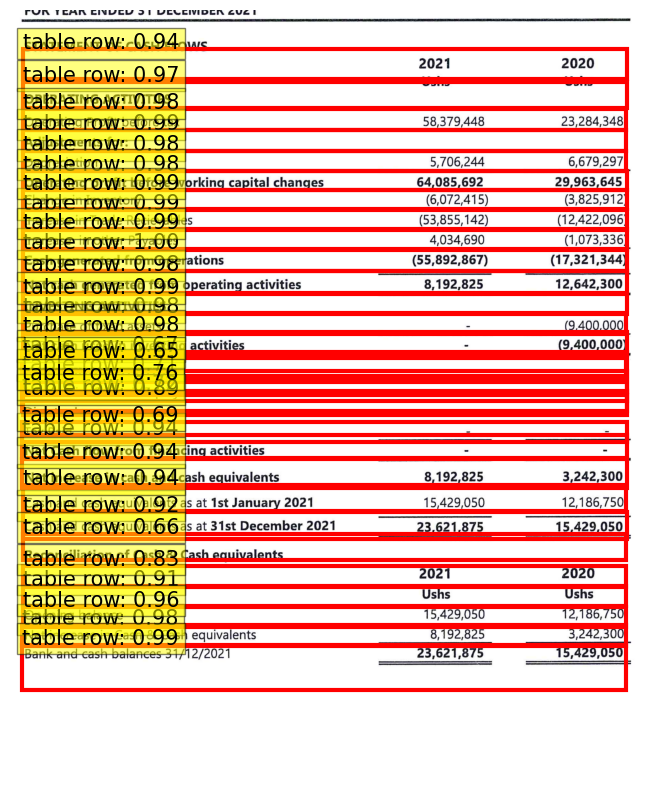

In [93]:
plot_results(cells, class_to_visualize="table row")

## Apply OCR row by row

First, we get the coordinates of the individual cells, row by row, by looking at the intersection of the table rows and columns (thanks ChatGPT!).

Next, we apply OCR on each individual cell, row-by-row.

Note that this makes some assumptions about the structure of the table: it assumes that the table has a rectangular, flat structure, containing a column header. One would need to update this for more complex table structures, potentially fine-tuning the detection and/or structure recognition model to be able to detect other layouts. Typically 50 labeled examples suffice for fine-tuning, but the more data you have, the better.

Alternatively, one could also do OCR column by column, etc.

In [94]:
def get_cell_coordinates_by_row(table_data):
    # Extract rows and columns
    rows = [entry for entry in table_data if entry['label'] == 'table row']
    columns = [entry for entry in table_data if entry['label'] == 'table column']

    # Sort rows and columns by their Y and X coordinates, respectively
    rows.sort(key=lambda x: x['bbox'][1])
    columns.sort(key=lambda x: x['bbox'][0])

    # Function to find cell coordinates
    def find_cell_coordinates(row, column):
        cell_bbox = [column['bbox'][0], row['bbox'][1], column['bbox'][2], row['bbox'][3]]
        return cell_bbox

    # Generate cell coordinates and count cells in each row
    cell_coordinates = []

    for row in rows:
        row_cells = []
        for column in columns:
            cell_bbox = find_cell_coordinates(row, column)
            row_cells.append({'column': column['bbox'], 'cell': cell_bbox})

        # Sort cells in the row by X coordinate
        row_cells.sort(key=lambda x: x['column'][0])

        # Append row information to cell_coordinates
        cell_coordinates.append({'row': row['bbox'], 'cells': row_cells, 'cell_count': len(row_cells)})

    # Sort rows from top to bottom
    cell_coordinates.sort(key=lambda x: x['row'][1])

    return cell_coordinates

cell_coordinates = get_cell_coordinates_by_row(cells)

In [95]:
len(cell_coordinates)

31

In [96]:
len(cell_coordinates[0]["cells"])

3

In [97]:
for row in cell_coordinates:
  print(row["cells"])

[{'column': [140.1122589111328, 384.81304931640625, 4115.51708984375, 7841.12939453125], 'cell': [140.1122589111328, 444.1051940917969, 4115.51708984375, 783.4368896484375]}, {'column': [4112.48583984375, 381.46942138671875, 5769.56396484375, 7964.72900390625], 'cell': [4112.48583984375, 444.1051940917969, 5769.56396484375, 783.4368896484375]}, {'column': [5773.3466796875, 394.79876708984375, 6976.6962890625, 7939.85888671875], 'cell': [5773.3466796875, 444.1051940917969, 6976.6962890625, 783.4368896484375]}]
[{'column': [140.1122589111328, 384.81304931640625, 4115.51708984375, 7841.12939453125], 'cell': [140.1122589111328, 809.81689453125, 4115.51708984375, 1113.2353515625]}, {'column': [4112.48583984375, 381.46942138671875, 5769.56396484375, 7964.72900390625], 'cell': [4112.48583984375, 809.81689453125, 5769.56396484375, 1113.2353515625]}, {'column': [5773.3466796875, 394.79876708984375, 6976.6962890625, 7939.85888671875], 'cell': [5773.3466796875, 809.81689453125, 6976.6962890625, 1

In [98]:
import numpy as np
import csv
import easyocr
from tqdm.auto import tqdm

reader = easyocr.Reader(['en']) # this needs to run only once to load the model into memory

def apply_ocr(cell_coordinates):
    # let's OCR row by row
    data = dict()
    max_num_columns = 0
    for idx, row in enumerate(tqdm(cell_coordinates)):
      row_text = []
      for cell in row["cells"]:
        # crop cell out of image
        cell_image = np.array(cropped_table.crop(cell["cell"]))
        # apply OCR
        result = reader.readtext(np.array(cell_image))
        if len(result) > 0:
          # print([x[1] for x in list(result)])
          text = " ".join([x[1] for x in result])
          row_text.append(text)
        else:
          row_text.append("")

      if len(row_text) > max_num_columns:
          max_num_columns = len(row_text)

      data[idx] = row_text

    print("Max number of columns:", max_num_columns)

    # pad rows which don't have max_num_columns elements
    # to make sure all rows have the same number of columns
    for row, row_data in data.copy().items():
        if len(row_data) != max_num_columns:
          row_data = row_data + ["" for _ in range(max_num_columns - len(row_data))]
        data[row] = row_data

    return data

data = apply_ocr(cell_coordinates)

for row, row_data in data.items():
    print(row_data)

100%|██████████| 31/31 [00:11<00:00,  2.76it/s]

Max number of columns: 3
['', '2021', '2020']
['OPERATING ACTIVITIES', '735ind', 'LeDd']
['Operating Profit before tax', '58,379,448', '23,284,348']
['Adjustments for:', '', '']
['Depreciation', '5,706,244', '6,679,297']
['Operating profit before working changes capital', '64,085,692', '29,963,645']
['Change in Inventory', '(6,072,415)', '(3,825,912)']
['Increase in Trade Recievables', '(53,855,142)', '(12,422,096)']
['Increase in other Payables', '4,034,690', '(1,073,336)']
['Cash generated from operations', '(55,892,867)', '(17,321,344)']
['Net cash generated from operating activities', '192,825 8,', '12,642,300']
['INVESTING ACTTVITIES', '', '']
['Purchase of fixed assets', '', '(9,400,000)']
['Net cash used in investing activities', '', '(9,400,000)']
['FTNANCING ACTTVTTES', '', '']
['FINANCING ACTTVITES', '', '']
['CINAncN0 AcTvACS 3 CL', '', '']
["Increase in Owner's Equity", '', '']
['increase T Uwnen $ Equily', '', '']
['E Director |oans', '', '']
['Tax Paid', '', '']
['Net Cas

## Save as CSV

We end up with a CSV file containing the data.

In [99]:
import csv

with open('output.csv','w') as result_file:
    wr = csv.writer(result_file, dialect='excel')

    for row, row_text in data.items():
      wr.writerow(row_text)

In [100]:
# Save the extracted data as CSV without altering the original format
df = pd.DataFrame.from_dict(data, orient='index')  # Convert the data dictionary to a DataFrame
df.to_csv("output_cropped_pic1_1002.csv", index=False, quoting=csv.QUOTE_ALL)  # Use quoting to avoid transformations


In [101]:
import pandas as pd

df = pd.read_csv("output_cropped_pic1_1002.csv")
df.head()

,0,1,2
0,NaN,2021,2020
1,OPERATING ACTIVITIES,735ind,LeDd
2,Operating Profit before tax,"58,379,448","23,284,348"
3,Adjustments for:,NaN,NaN
4,Depreciation,"5,706,244","6,679,297"


In [103]:
import pandas as pd
#save as csv
df = pd.DataFrame(data)
df.to_csv("output_cropped_pic1_1002.csv", index=False)

#df = pd.read_csv("output.csv")
#df = pd.read_csv("output_cropped_pic1.csv")
df.head()

,0,1,2,3,4,5,6,7,8,9,...,21,22,23,24,25,26,27,28,29,30
0,,OPERATING ACTIVITIES,Operating Profit before tax,Adjustments for:,Depreciation,Operating profit before working changes capital,Change in Inventory,Increase in Trade Recievables,Increase in other Payables,Cash generated from operations,...,Net Cash flow from financing activities,Net increase in cash and cash equivalents,Cash and cash equivalents as at Ist January 2021,Cash and cash equivalents as at 31st December ...,Reconciliation of Cash & Cash equivalents,,,Opening balance,Net increase in Cash & Cash equivalents,Bank and cash balances 31/12/2021
1,2021,735ind,"58,379,448",,"5,706,244","64,085,692","(6,072,415)","(53,855,142)","4,034,690","(55,892,867)",...,,"192,825 8,","15,429,050","23,621,875",,2021,Ushs,"15, 1 429,050","8,192,825","621,875 23,"
2,2020,LeDd,"23,284,348",,"6,679,297","29,963,645","(3,825,912)","(12,422,096)","(1,073,336)","(17,321,344)",...,,"3,242,300","12,186,750","429,050 15,",,2020,Ushs,"186,750 12,","3,242,300","15,429,050"
